<a href="https://colab.research.google.com/github/Mafaz03/Test-Checkpoints/blob/main/midas_based_animation_3(pointer).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#1 Importing Dependencies

In [1]:
#Dependencies related to predictions and visualization
import torch
import cv2 as cv
import matplotlib.pyplot as plt
import time
import numpy as np
from google.colab.patches import cv2_imshow

In [2]:
#Dependencies related to files
import os
from pathlib import Path
import requests
import zipfile

In [3]:
#Supporting module
import time
try:
  import timm
except:
  !pip install timm -q
  import timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 47.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 18.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 32.2 MB/s eta 0:00:00


In [4]:
#to measure itteration and total timefor execution
from tqdm import tqdm_notebook as tqdm

In [5]:
#Setting device
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

#2 Setting MiDaS

In [6]:
#Imorting small midas model

model_type = "MiDaS_small"

midas = torch.hub.load("intel-isl/MiDaS" , model_type)

midas.to(device)

/usr/local/lib/python3.10/dist-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/intel-isl/MiDaS/zipball/master" to /root/.cache/torch/hub/master.zip


Loading weights:  None


Downloading: "https://github.com/rwightman/gen-efficientnet-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_lite3-b733e338.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_lite3-b733e338.pth
Downloading: "https://github.com/isl-org/MiDaS/releases/download/v2_1/midas_v21_small_256.pt" to /root/.cache/torch/hub/checkpoints/midas_v21_small_256.pt
100%|██████████| 81.8M/81.8M [00:00<00:00, 190MB/s]


MidasNet_small(
  (pretrained): Module(
    (layer1): Sequential(
      (0): Conv2dSameExport(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
      (1): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
      (3): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
          (act1): ReLU6(inplace=True)
          (se): Identity()
          (conv_pw): Conv2d(32, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
          (act2): Identity()
        )
      )
      (4): Sequential(
        (0): InvertedResidual(
          (conv_pw): Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(144,

In [7]:
#importing large and small transforms for midas
midas_transforms = torch.hub.load("intel-isl/MiDaS" , "transforms")

transform = midas_transforms.small_transform

transform

Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master


Compose(
    <function transforms.<locals>.<lambda> at 0x7fd46118ec20>
    <function transforms.<locals>.<lambda> at 0x7fd46118ecb0>
)

#3 Downloading image sequence

In [8]:
data_path = Path("data/")
seq_path = data_path / "seq_path"

seq_path.mkdir(parents = True , exist_ok = True)

file_name = "simulation_sequence.zip"
with open(data_path / file_name , "wb") as f:
  request = requests.get("https://github.com/Mafaz03/Datasets/raw/Sequence/Path_simulation_sequence/Path_simulation_sequence.zip")
  f.write(request.content)

with zipfile.ZipFile(data_path / file_name) as zip:
  zip.extractall(seq_path)

In [9]:
seq0001 = cv.imread("/content/data/seq_path/Path_simulation0080.png")

seq0001 = cv.cvtColor(seq0001, cv.COLOR_BGR2RGB)#convering cv2's BGR to RGB

size = seq0001.shape[:2]
print(f"image size : {size}")

image size : (1080, 1920)


#3.1 Plotting few images sequence

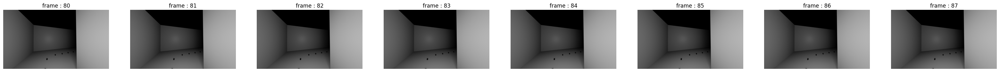

In [10]:
plt.figure(figsize = (40 , 40))
num_of_img = 8
start = 80


for seq in range(num_of_img):
  plt.subplot(1,num_of_img,seq+1)
  image = plt.imread(seq_path/ f"Path_simulation00{start + num_of_img}.png")
  plt.imshow(image)
  plt.title(f"frame : {start + seq}")
  plt.axis("off")

#4 Predicting

In [11]:
sequence_transformed = transform(seq0001).to(device)
print(sequence_transformed.shape)

torch.Size([1, 3, 128, 256])


In [12]:
start_time = time.time()

brighest_points_seq = {}

with torch.no_grad():
  prediction = midas(sequence_transformed)

  prediction = torch.nn.functional.interpolate(
    prediction.unsqueeze(1),
    size = size,
    mode="bicubic",
    align_corners=False,
  ).squeeze()

  depth_map = prediction.cpu().numpy()
  depth_map = cv.normalize(depth_map , None , 0 , 1 , norm_type = cv.NORM_MINMAX , dtype = cv.CV_64F)
  depth_map_data = depth_map
  depth_map = (depth_map*255).astype(np.uint8)
  depth_map = cv.applyColorMap(depth_map , cv.COLORMAP_MAGMA)

end_time = time.time()
print(f"Time taken for execution : {end_time - start_time}")

Time taken for execution : 0.4632890224456787


#5 Plotting predictions

(-0.5, 1919.5, 1079.5, -0.5)

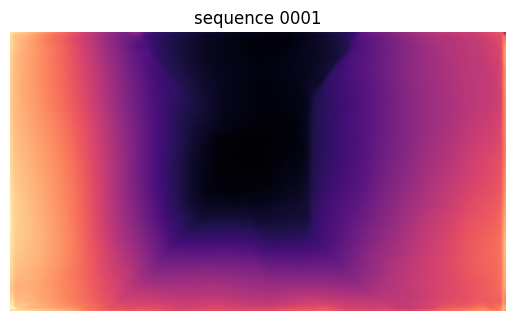

In [13]:
depth_map = cv.cvtColor(depth_map , cv.COLOR_BGR2RGB)
plt.imshow(depth_map)
plt.title("sequence 0001")
plt.axis("off")

##5.1 Cropping predictions

In [14]:
depth_map_cropped = depth_map[ 400 : 650 ,  0 : size[1] ] #Cropping

In [15]:
size_cropped = depth_map_cropped.shape[:2]
depth_map.shape
size_cropped , depth_map.shape

((250, 1920), (1080, 1920, 3))

(-0.5, 1919.5, 249.5, -0.5)

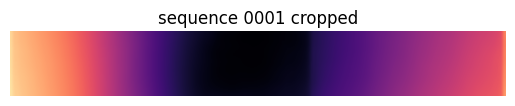

In [16]:
plt.imshow(depth_map_cropped)
plt.title("sequence 0001 cropped")
plt.axis("off")

##5.2 Saving croped predictions

In [17]:
dept_seq_path = data_path / "Depth_map_sequence"
dept_seq_path.mkdir(parents = True , exist_ok = True)

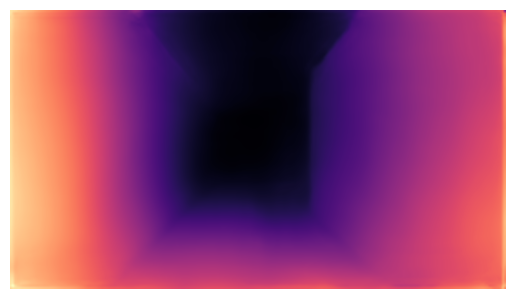

In [18]:
fig, ax = plt.subplots( nrows=1, ncols=1 )
file_name = "Depth_map_" + str(1)
fig.savefig(f"/content/data/Depth_map_sequence/{file_name}")
plt.axis("off")
ax.imshow(depth_map)

##5.3 Segmenting croped predictions

In [19]:
def segments(amount : int , width : int) -> list[tuple[int]]:

  slice_list = []
  amount = 10

  sections = width // amount

  beg = sections
  temp = 0
  for batches in range(amount):
    section = sections + temp

    if batches == 0:
      # print( 0 , section)
      slice_list.append((0 , sections))
    else:
      # print(beg , beg + sections)
      slice_list.append((beg , beg + sections))
      beg += sections

  return slice_list

In [20]:
seg = segments(amount = 10 , width = size_cropped[1])
seg

[(0, 192),
 (192, 384),
 (384, 576),
 (576, 768),
 (768, 960),
 (960, 1152),
 (1152, 1344),
 (1344, 1536),
 (1536, 1728),
 (1728, 1920)]

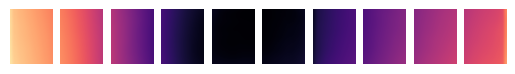

In [21]:
brightest_points = {}

for segments in range(len(seg)):
  plt.subplot(1 , len(seg) , segments + 1)
  depth_map_cropped_seg = depth_map_cropped[0 : size_cropped[0] , seg[segments][0] : seg[segments][1] ]
  cropped_data = depth_map_data[0 : size_cropped[0] , seg[segments][0] : seg[segments][1] ]
  brightest_point = np.max(cropped_data)
  brightest_points[segments + 1] = round(brightest_point  , 2)
  plt.imshow(depth_map_cropped_seg)
  plt.axis("off")


In [22]:
brightest_points

{1: 0.95,
 2: 0.71,
 3: 0.47,
 4: 0.22,
 5: 0.08,
 6: 0.07,
 7: 0.26,
 8: 0.43,
 9: 0.54,
 10: 0.81}

In [23]:
list(brightest_points.values())

[0.95, 0.71, 0.47, 0.22, 0.08, 0.07, 0.26, 0.43, 0.54, 0.81]

In [24]:
def inverse_brightest_points(points : dict) -> dict[int, float]:
  val = list(points.values())
  for values in range(1 , len(points)+1):
    points[values] = round( 1 - val[values-1] , 2)
  return(points)

inverse_brightest_points(brightest_points)

{1: 0.05,
 2: 0.29,
 3: 0.53,
 4: 0.78,
 5: 0.92,
 6: 0.93,
 7: 0.74,
 8: 0.57,
 9: 0.46,
 10: 0.19}

In [25]:
theta = np.linspace(0, 2 * np.pi -1 , 10)
theta = np.append(theta , theta[0])
len(theta) == len(seg) + 1

True

#6 Plotting polar plot

In [26]:
def polar_plot(brightest_points : dict , title : str , marker ,
               save_path : str = None , rotation = 0 ):
  brightest_points_inv = inverse_brightest_points(brightest_points)

  theta = np.linspace(0, 2 * np.pi -1 , 10)

  theta_degrees = np.degrees(theta)

  fig = plt.figure(figsize = (7,7))
  ax = fig.add_subplot(111, polar=True)

  # if len(list(brightest_points_inv.values())) + 1 != len(seg) :
  theta = np.append(theta , theta[0])
  brightest_points_inv[len(brightest_points_inv)+1] = list(brightest_points_inv.values())[0]

  ax.set_rticks([i/4 for i in range(5)])

  ax.plot(theta, brightest_points_inv.values() , marker = marker)

  if save_path != None:
    fig.savefig(save_path)
  plt.title(title)

  return theta_degrees

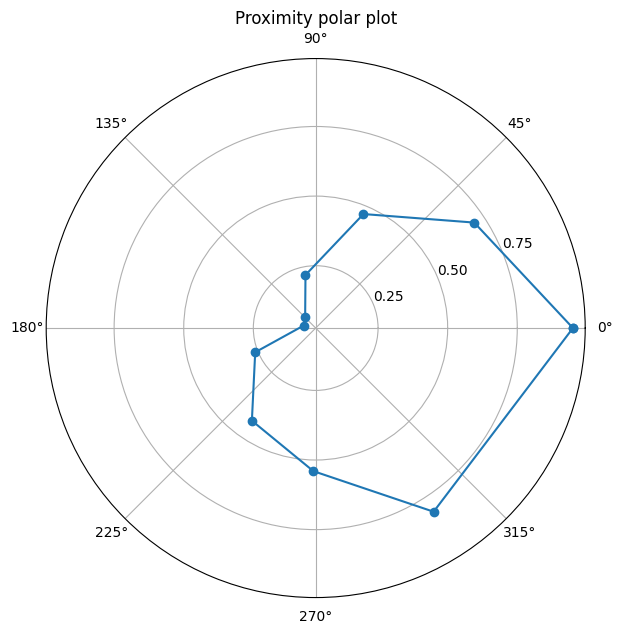

In [27]:
theta = polar_plot(brightest_points , title = "Proximity polar plot" ,
           marker = "o" , rotation = 90 ) #closest proximity value is lower

In [28]:
inverse_brightest_points(brightest_points)

{1: 0.05,
 2: 0.29,
 3: 0.53,
 4: 0.78,
 5: 0.92,
 6: 0.93,
 7: 0.74,
 8: 0.57,
 9: 0.46,
 10: 0.19,
 11: 0.05}

In [29]:
dept_seq_path = data_path / "Depth_map_sequence"
dept_seq_path.mkdir(parents = True , exist_ok = True)

#8 Sequencing the frames -> Predicting and Plotting

In [30]:
def convert0(num : int) -> int:
  if len(str(num)) <= 4:
    appendings = 4 - len(str(num))
    return(str(0)*appendings + str(num))

convert0(34)

'0034'

In [31]:
seq0001 = cv.imread("/content/data/seq_path/Path_simulation0001.png")

seq0001 = cv.cvtColor(cv.imread("/content/data/seq_path/Path_simulation0001.png"),
                      cv.COLOR_BGR2RGB) #convering cv2's BGR to RGB

sequence_transformed = transform(seq0001).to(device)
sequence_transformed

tensor([[[[0.2176, 0.2294, 0.2120,  ..., 0.0919, 0.1007, 0.1101],
          [0.2439, 0.2139, 0.2138,  ..., 0.0916, 0.1081, 0.1044],
          [0.2387, 0.2392, 0.2317,  ..., 0.0889, 0.1200, 0.1075],
          ...,
          [0.2233, 0.2199, 0.2061,  ..., 0.0277, 0.0398, 0.0600],
          [0.2102, 0.1980, 0.2063,  ..., 0.0231, 0.0254, 0.0376],
          [0.2093, 0.1941, 0.1906,  ..., 0.0172, 0.0228, 0.0223]],

         [[0.3520, 0.3640, 0.3462,  ..., 0.2234, 0.2324, 0.2420],
          [0.3788, 0.3481, 0.3481,  ..., 0.2231, 0.2400, 0.2362],
          [0.3735, 0.3740, 0.3663,  ..., 0.2204, 0.2521, 0.2394],
          ...,
          [0.3577, 0.3543, 0.3401,  ..., 0.1578, 0.1702, 0.1908],
          [0.3443, 0.3319, 0.3404,  ..., 0.1530, 0.1555, 0.1679],
          [0.3434, 0.3279, 0.3243,  ..., 0.1471, 0.1527, 0.1522]],

         [[0.5726, 0.5846, 0.5669,  ..., 0.4447, 0.4536, 0.4631],
          [0.5993, 0.5688, 0.5688,  ..., 0.4443, 0.4611, 0.4573],
          [0.5941, 0.5945, 0.5869,  ..., 0

In [32]:
plor_plot_path = data_path / "Plor_plot"
plor_plot_path.mkdir(parents = True , exist_ok = True)

#8.1 Generating Sequence of depth map prediction

In [33]:
num_of_images = 250

In [35]:
def segments(amount : int , width : int) -> list[tuple[int]]:

  slice_list = []
  amount = 10

  sections = width // amount

  beg = sections
  temp = 0
  for batches in range(amount):
    section = sections + temp

    if batches == 0:
      # print( 0 , section)
      slice_list.append((0 , sections))
    else:
      # print(beg , beg + sections)
      slice_list.append((beg , beg + sections))
      beg += sections

  return slice_list

<ipython-input-36-8e765bc910c1>:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for image_seq in tqdm(range(1 , num_of_images + 1)) :


  0%|          | 0/250 [00:00<?, ?it/s]

<ipython-input-36-8e765bc910c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,1,1)
<ipython-input-36-8e765bc910c1>:36: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1 , len(seg) , segments + 1)


Time taken for execution : 165.9404218196869


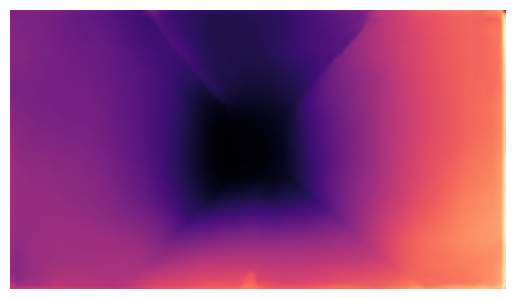

In [36]:
start_time = time.time()

brightest_points_seq = {}

seg = segments(amount = 10 , width = size_cropped[1])

for image_seq in tqdm(range(1 , num_of_images + 1)) :

  brightest_points = {}

  with torch.no_grad():


    seq = cv.cvtColor(cv.imread("/content/data/seq_path/Path_simulation"+convert0(image_seq)+".png"),
                      cv.COLOR_BGR2RGB) #convering cv2's BGR to RGB
    sequence_transformed = transform(seq).to(device)

    prediction = midas(sequence_transformed)

    prediction = torch.nn.functional.interpolate(
      prediction.unsqueeze(1),
      size = size,
      mode="bicubic",
      align_corners=False,
    ).squeeze()

  # fig, ax = plt.subplots( nrows=1, ncols=1 )
  depth_map = prediction.cpu().numpy()
  depth_map = cv.normalize(depth_map , None , 0 , 1 , norm_type = cv.NORM_MINMAX , dtype = cv.CV_64F)
  depth_map_data = depth_map
  depth_map = (depth_map*255).astype(np.uint8)
  depth_map = cv.applyColorMap(depth_map , cv.COLORMAP_MAGMA)
  depth_map = cv.cvtColor(depth_map , cv.COLOR_BGR2RGB)

  for segments in range(len(seg)):
    plt.subplot(1 , len(seg) , segments + 1)
    depth_map_cropped_seg = depth_map_cropped[0 : size_cropped[0] , seg[segments][0] : seg[segments][1] ]
    cropped_data = depth_map_data[0 : size_cropped[0] , seg[segments][0] : seg[segments][1] ]
    brightest_point = np.max(cropped_data)
    brightest_points[segments + 1] = round(brightest_point  , 2)
    plt.axis("off")
  plt.subplot(1,1,1)
  depth_map_cropped = depth_map[ 400 : 650 ,  0 : size[1] ]
  depth_map_cropped = cv.cvtColor(depth_map_cropped , cv.COLOR_BGR2RGB)

  file_name = "Depth_map_" + str(image_seq)
  plt.axis("off")
  plt.imshow(depth_map)
  plt.savefig(f"/content/data/Depth_map_sequence/{file_name}")
  plt.axis("off")
  brightest_points_seq[image_seq] = brightest_points

end_time = time.time()
print(f"Time taken for execution : {end_time - start_time}")

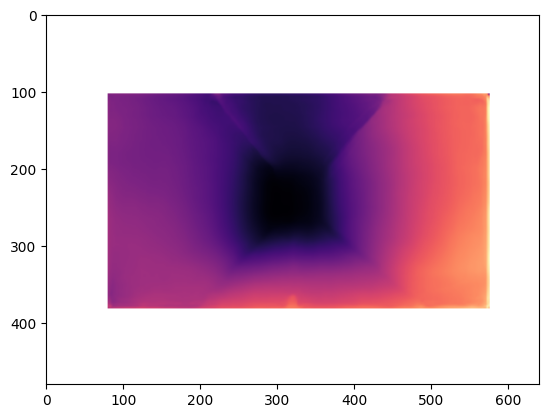

In [37]:
plt.imshow(plt.imread("/content/data/Depth_map_sequence/Depth_map_250.png"))

In [38]:
len(brightest_points_seq)

250

In [39]:
brightest_points_seq[6]

{1: 0.89,
 2: 0.77,
 3: 0.64,
 4: 0.4,
 5: 0.21,
 6: 0.18,
 7: 0.32,
 8: 0.42,
 9: 0.41,
 10: 0.8}

In [40]:
pointer_path = data_path / "Pointer_path"

pointer_path.mkdir(parents = True , exist_ok = True)

file_name = "pointer_path.zip"
with open(data_path / file_name , "wb") as f:
  request = requests.get("https://github.com/Mafaz03/Datasets/raw/main/Pointer.zip")
  f.write(request.content)

with zipfile.ZipFile(data_path / file_name) as zip:
  zip.extractall(pointer_path)

In [41]:
pointer_degree = [x for x in range(30 , 160 , 10)]
pointer_degree

[30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150]

In [42]:
ele = brightest_points_seq[6]
arr = np.array(list(ele.values()))
indexes = np.argsort(arr)[:3]
list(indexes)

[5, 4, 6]

In [43]:
def normalize_and_closest(elements2 : np.ndarray , elements1 : np.ndarray , min_val : int = 0 , max_val : int = 0 ) -> int:

  arr = np.array(elements1)
  pointer_degree = np.array(elements2)

  # Normalize the array
  normalized_arr = (arr - np.min(arr)) / (np.max(arr) - np.min(arr))
  scaled_arr = normalized_arr * (max_val - min_val) + min_val

  l = list(scaled_arr)
  sum = 0
  for ele in l :
    sum += ele
  avg = sum / len(l)

  # Finding the index of the element closest to the average degree value
  index = np.abs(pointer_degree - avg).argmin()

  pointer_point_degree = pointer_degree[index]
  return pointer_point_degree

In [45]:
pointer_degree = [x for x in range(30 , 160 , 20)]
pointer_degree

[30, 50, 70, 90, 110, 130, 150]

In [46]:
suddenness = 2

for image_num in tqdm(range(1 , num_of_images + 1)):
  ele = brightest_points_seq[image_num]
  arr = np.array(list(ele.values()))
  indexes = np.argsort(arr)[:3]
  pointer_point_degree = normalize_and_closest(elements1 = indexes , elements2 = pointer_degree, min_val = 0 , max_val = 180)

  if pointer_point_degree > 90:
    pointer_point_degree = pointer_point_degree + (pointer_point_degree - 90)*2
  else:
    pointer_point_degree = pointer_point_degree - (pointer_point_degree - 90)*2

  print(pointer_point_degree)

<ipython-input-46-d8cb12f5c376>:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for image_num in tqdm(range(1 , num_of_images + 1)):


  0%|          | 0/250 [00:00<?, ?it/s]

90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
110
90
90
90
90
110
90
110
90
150
150
90
90
90
90
90
90
90
90
90
90
90
110
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
150
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
110
90
90
90
90
90
90
90
90
110
90
90
90
90
90
90
110
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
90
110
90
90
90
150
90
90
90
90
90
110
90
110
90
90
150
90
90
90
90
90
90
90
90
90
90
90
90
90
90


(-0.5, 1919.5, 1079.5, -0.5)

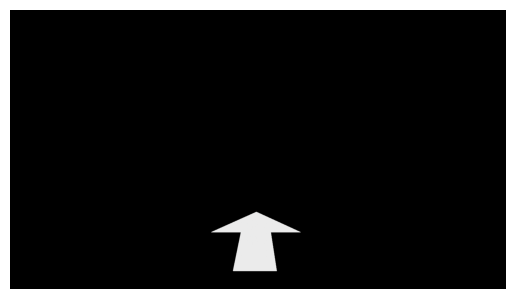

In [47]:
plt.imshow(cv.imread(f"/content/data/Pointer_path/Pointer/{pointer_point_degree}.png"))
plt.axis("off")

In [48]:
pointer_seq_path = data_path / "Pointer_seq"
pointer_seq_path.mkdir(parents = True , exist_ok = True)

<ipython-input-50-747a63cdfd5f>:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for image_num in tqdm(range(1 , num_of_images + 1)):


  0%|          | 0/250 [00:00<?, ?it/s]

Time taken for execution : 5564.427393198013


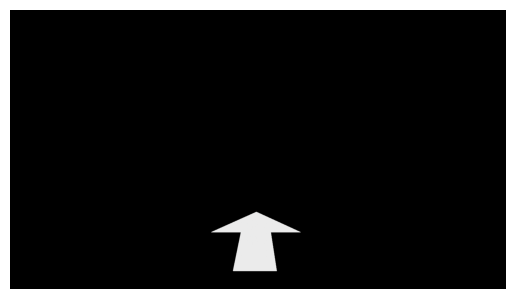

In [50]:
start_time = time.time()
suddenness = 2

for image_num in tqdm(range(1 , num_of_images + 1)):
  ele = brightest_points_seq[image_num]
  arr = np.array(list(ele.values()))
  indexes = np.argsort(arr)[:3]
  pointer_point_degree = normalize_and_closest(elements1 = indexes ,
                                               elements2 = pointer_degree, min_val = 0 ,
                                               max_val = 180)

  if pointer_point_degree > 90:
    pointer_point_degree = pointer_point_degree + (pointer_point_degree - 90)*2
  else:
    pointer_point_degree = pointer_point_degree - (pointer_point_degree - 90)*2

  plt.imshow(cv.imread(f"/content/data/Pointer_path/Pointer/{pointer_point_degree}.png"))
  plt.axis("off")
  file_name = f"Pointer_{str(pointer_point_degree)}_{str(image_num-1)}"
  plt.savefig(f"/content/data/Pointer_seq/{file_name}")

end_time = time.time()
print(f"Time taken for execution : {end_time - start_time}")

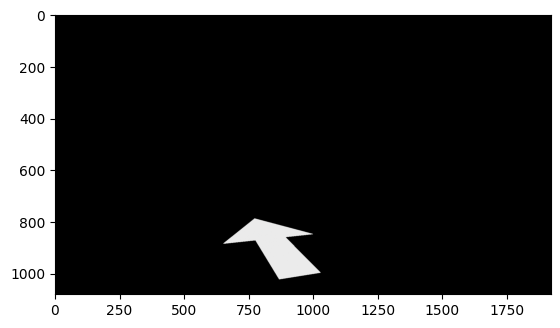

In [51]:
pointer_point_degree = 110
plt.imshow(cv.imread(f"/content/data/Pointer_path/Pointer/{pointer_point_degree}.png"))

#8.1 Generating Sequence of Polar plot of prediction

<ipython-input-52-f1456378e178>:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for image_seq in tqdm(range(1 , num_of_images+1)):


  0%|          | 0/250 [00:00<?, ?it/s]

<ipython-input-26-0f24e60395a9>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize = (7,7))


Time taken for execution : 41.84225678443909


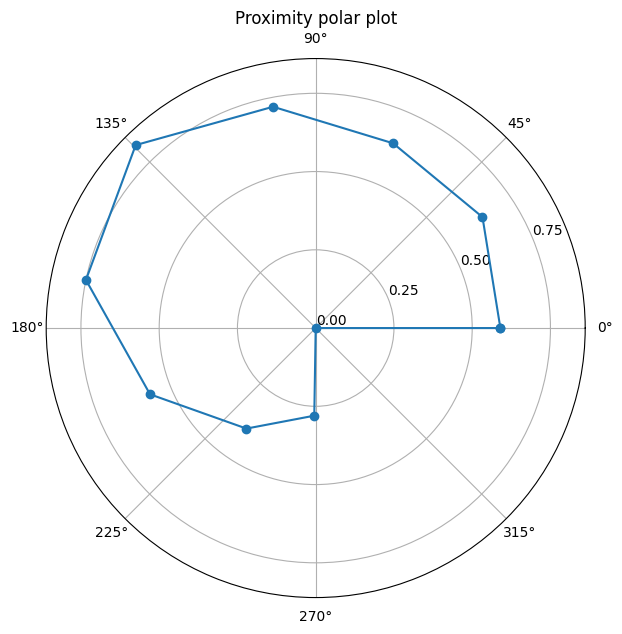

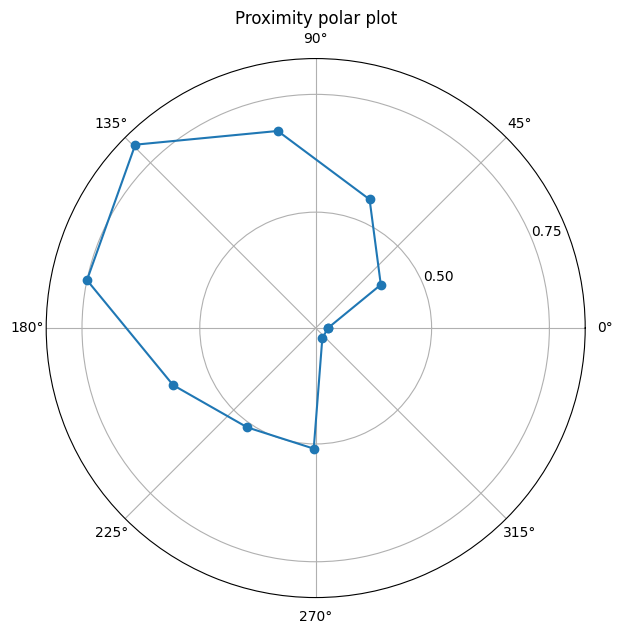

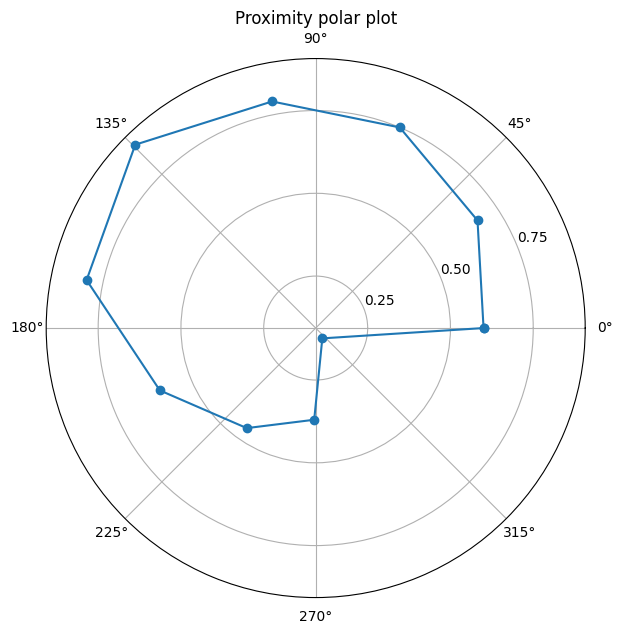

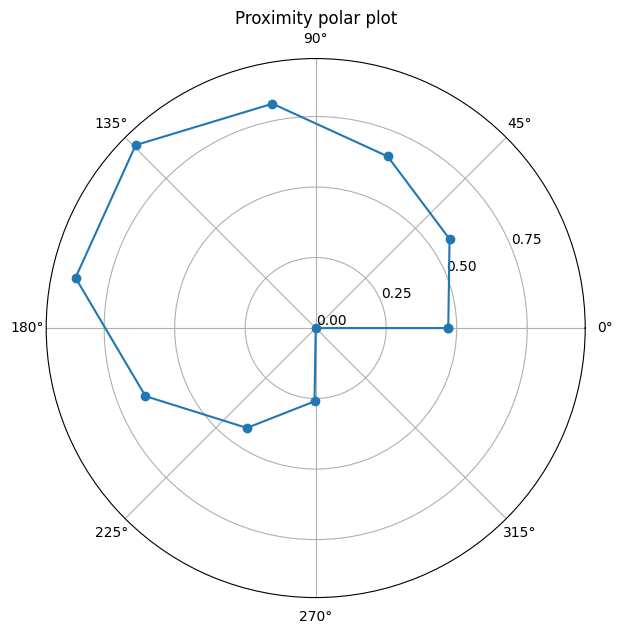

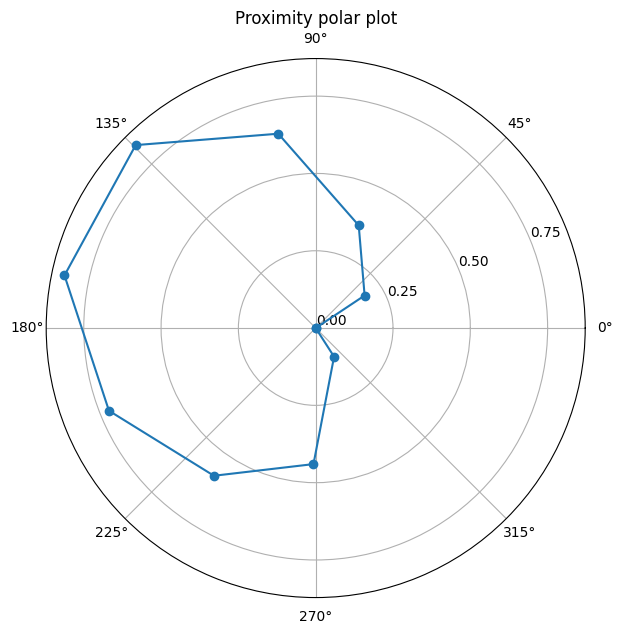

...

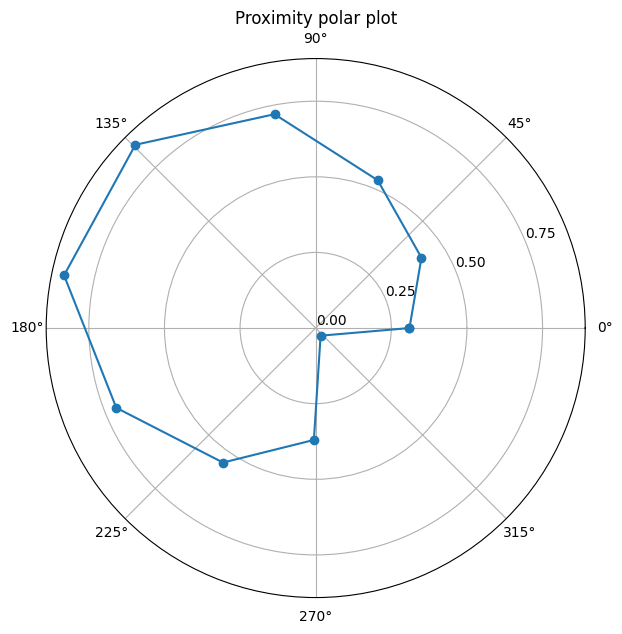

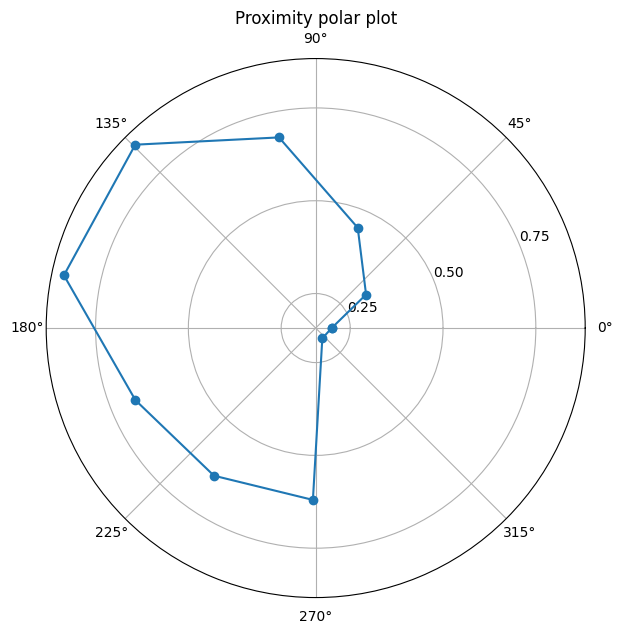

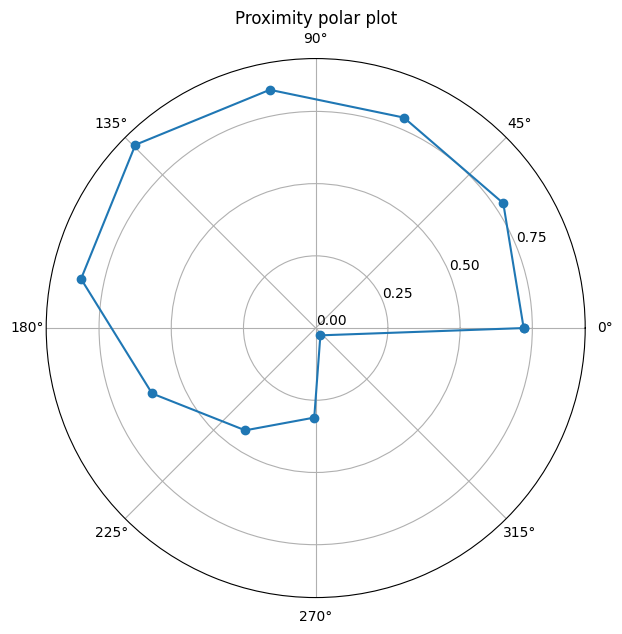

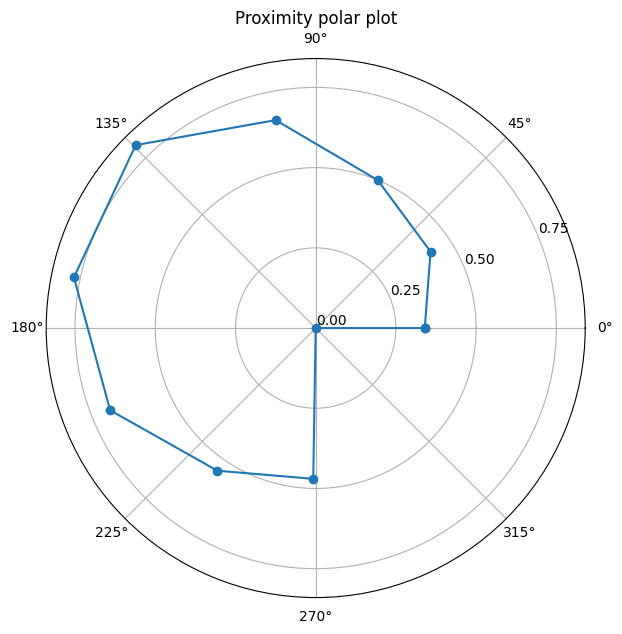

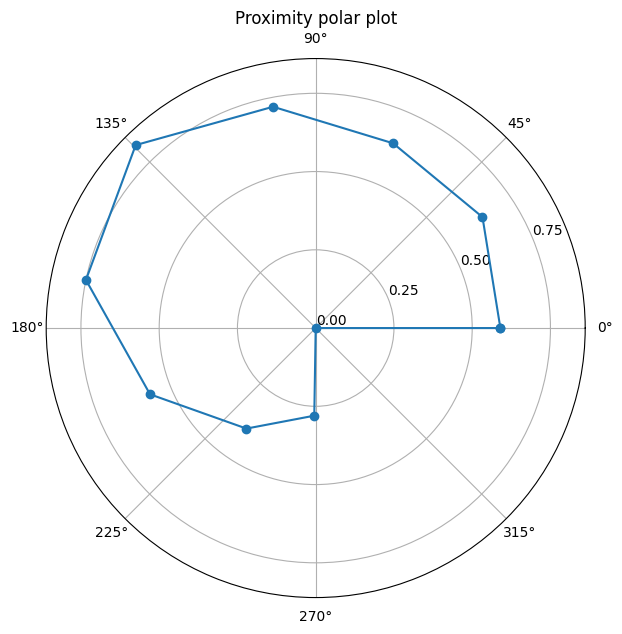

In [52]:
start_time = time.time()

num_of_images = 250

for image_seq in tqdm(range(1 , num_of_images+1)):

  polar_plot(brightest_points_seq[image_seq] , title = "Proximity polar plot" ,
           marker = "o" , rotation = 90 ,
           save_path = f"/content/data/Plor_plot/Polar_plot{str(image_seq)}") #closest proximity value is lower

end_time = time.time()
print(f"Time taken for execution : {end_time - start_time}")


#9 Zipping Prediction and Plot sequence

In [53]:
!zip -r /content/data_depth_map.zip /content/data/Depth_map_sequence

  adding: content/data/Depth_map_sequence/ (stored 0%)
  adding: content/data/Depth_map_sequence/Depth_map_25.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_67.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_31.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_71.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_122.png (deflated 4%)
  adding: content/data/Depth_map_sequence/Depth_map_88.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_55.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_124.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_222.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_73.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_131.png (deflated 4%)
  adding: content/data/Depth_map_sequence/Depth_map_168.png (deflated 3%)
  adding: content/data/Depth_map_sequence/Depth_map_102.png (def

In [54]:
!zip -r /content/data/plor_plot.zip /content/data/Plor_plot

  adding: content/data/Plor_plot/ (stored 0%)
  adding: content/data/Plor_plot/Polar_plot68.png (deflated 9%)
  adding: content/data/Plor_plot/Polar_plot74.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot114.png (deflated 9%)
  adding: content/data/Plor_plot/Polar_plot50.png (deflated 9%)
  adding: content/data/Plor_plot/Polar_plot215.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot81.png (deflated 9%)
  adding: content/data/Plor_plot/Polar_plot6.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot145.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot155.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot233.png (deflated 10%)
  adding: content/data/Plor_plot/Polar_plot170.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot27.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot175.png (deflated 9%)
  adding: content/data/Plor_plot/Polar_plot173.png (deflated 8%)
  adding: content/data/Plor_plot/Polar_plot248.png

In [55]:
!zip -r /content/data/pointer_seq.zip /content/data/Pointer_seq

  adding: content/data/Pointer_seq/ (stored 0%)
  adding: content/data/Pointer_seq/Pointer_110_232.png (deflated 37%)
  adding: content/data/Pointer_seq/Pointer_90_221.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_69.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_207.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_120.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_147.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_68.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_193.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_24.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_142.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_56.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_19.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_246.png (deflated 41%)
  adding: content/data/Pointer_seq/Pointer_90_122.png (defl